# Documentation for Hydra Multi-Asset Verification Test

## Composite Action Tests
The methodology for the tests is 
- A comparison of two models: 
    - 1 Hydra system and 
    - 1 Uniswap instance
- Duplication of:
    - identical transactions in the modeled Hydra system 
    - in modeled Uniswap instances of reserve token R_x paired with pooled Hydra Q.

## Description of testcase represented in this notebook

This jupyter notebook summerizes the results of the following experiment
- The agent trades q for i..
- 
-
-



## Test settings

exo_trade = ['test_q_for_r'] # agent 0

exo_liq = ['test_remove'] # agent 3

exo_asset = ['alternating']

exo_composite = ['alternating'] 

## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Model File structure
* Test Notebooks .ipynb
* model

In the model folder there exist 4 files and a parts folder, the [config.py](model/config.py), [partial_state_update_block.py](model/partial_state_update_block.py), [run.py](model/run.py), and [state_variables.py](state_variables.py). The [config.py](model/config.py) contains the simulation configurations, aggregating the partial states, and the state variables. The [partial_state_update_block.py](model/partial_state_update_block.py) contains the partial state update blocks and how they update the state variables. [state_variables.py](state_variables.py) defines the state variables and [run.py](model/run.py) actually runs the simulation. [plot_utils.py](model/plot_utils.py) contain the plotting functions used to generate the analysis.

The components of the model live within the parts subfolder as:

* [action.py](model/parts/action.py) 
    * Action dictionary drives the model. Currently, actions are prescribed actions in testing mode. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.  

* [uniswap.py](model/parts/uniswap.py)
    * Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance (currently R_i<>Q pair and R_j<>Q pair) and its requisite state variable: UNI_Qx, UNI_Rx, and UNI_Sx.

    * [utils.py](model/parts/utils.py) 
        * Computes the state update for each Uniswap state variable
        
    * [agent_utils.py](model/parts/agent_utils.py) 
        * Computes the corresponding agent local state for each Uniswap agent resolving their action

* [hydra.py](model/parts/hydra.py)
    * Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
    * [hydra_utils.py](model/parts/hydra_utils.py) 
        * Computes the state update for each Hydra state variable

    * [asset_utils.py](model/parts/asset_utils.py) 
        * Computes the state update for each Reserve Asset in a Hydra Omnipool

    * [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py) 
        * Computes the corresponding agent local state for each Hydra agent resolving their action
        
The initial parameters and hyperparameters of the system are defined in [sys_params.py](model/sys_params.py) and helper functions, plots, etc. are in the [utils.py](model/parts/utils.py).


### Model dataset*


## Run Model

The following command lines import all packages, experiments and run the model 

In [1]:
# Dependencies
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

df = run.run()
rdf = run.postprocessing(df)
# rdf = df # debugging substeps



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 1
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (1000, 7, 1, 15)
Execution Method: local_simulations
SimIDs   : [0]
SubsetIDs: [0]
Ns       : [0]
ExpIDs   : [0]
Execution Mode: single_threaded
Total execution time: 4.77s


## Analysis

For information on how to access and analysis data from the Eth/Dai Uniswap smart contract, visit our sister notebook [here](Uniswap_EthDai_Exchange_Data.ipynb).

The following command lines create
- the model_history, which is a list of asset quantities $\begin{pmatrix} Q_i, R_i, S_i \end{pmatrix}$ counting the i-th base asset, the risk asset and the shares of the risk asset respectively.
- the uniswap_j, which is a list of asset quantities $\begin{pmatrix} Q_j, R_j, S_j \end{pmatrix}$ counting the j-th base asset, the risk asset and the shares of the risk asset respectively., and
- hydra, which is a list of quantities $\begin{pmatrix} Q, H, S_q \end{pmatrix}$ counting the base asset amount in the pool, the total base asset supply and the shares of the base asset respectively.




In [2]:
model_history = rdf[['UNI_Qi', 'UNI_Ri', 'UNI_Si']]
model_history.columns = ['model_UNI_Qi', 'model_UNI_Ri', 'model_UNI_Si']

uniswap_j = rdf[['UNI_Qj', 'UNI_Rj', 'UNI_Sj']]
uniswap_j.columns = ['UNI_Qj', 'UNI_Rj', 'UNI_Sj']

hydra = rdf[['Q', 'H', 'Sq']]
hydra.columns = ['Hydra_Q', 'Hydra_H', 'Hydra_Sq']

The following command line shows the first (1st) iteration of the pool instance for the $i$-th and the $j$-th asset respectively listing the realizations of the variables $R$ (asset quantity), $S$ (share quantity), $W$ (weight quantity = share quantity), $P$ (price) and $dP$ (change in price).

In [3]:
print(rdf.pool[rdf.first_valid_index()])

<class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 1000000, 'S': 200000000000, 'W': 200000000000, 'P': 0.19999999999999998, 'dP': 0.0}, 'j': {'R': 1000000, 'S': 200000000000, 'W': 200000000000, 'P': 0.19999999999999998, 'dP': 0.0}, 'k': {'R': 1000000, 'S': 200000000000, 'W': 200000000000, 'P': 0.19999999999999998, 'dP': 0.0}}}


In [4]:
rdf.pool[rdf.first_valid_index()].pool

{'i': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.19999999999999998,
  'dP': 0.0},
 'j': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.19999999999999998,
  'dP': 0.0},
 'k': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.19999999999999998,
  'dP': 0.0}}

The following command line shows the tenth (10th) iteration of the pool instance

In [5]:
rdf.pool[rdf.first_valid_index()*10].pool

{'i': {'R': 997512.1554097746,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.20074943339185475,
  'dP': 0.0001500360406118395},
 'j': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.20024999999999998,
  'dP': 4.999999999999449e-05},
 'k': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.20024999999999998,
  'dP': 4.999999999999449e-05}}

The following command line shows the final iteration of the pool instance


In [6]:
rdf.pool[rdf.last_valid_index()].pool

{'i': {'R': 790681.9672875978,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.2845644763745571,
  'dP': 0.00018928832954800967},
 'j': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.22499999999999998,
  'dP': 5.000000000002225e-05},
 'k': {'R': 1000000,
  'S': 200000000000,
  'W': 200000000000,
  'P': 0.22499999999999998,
  'dP': 5.000000000002225e-05}}

The following command line shows a table of the first five iterations of the pool instance, visualizing all variables
- UNI_Qi...the quantity of the i-th assets base
- UNI_Ri...the quantity of the i-th assets risk
- UNI_Si...the quantity of the i-th assets shares
- UNI_Qj...the quantity of the j-th assets base
- UNI_Rj...the quantity of the j-th assets risk
- UNI_Sj...the quantity of the j-th assets shares
- uni_agents...the definition of the actions of the uniswap agents
- UNI_P_RQi...the price of the i-th risk asset in terms of Q
- UNI_P_RQj...the price of the j-th risk asset in terms of Q
- pool...the definition of the pool instance
- Q...the quantity of the base asset in the hydra pool
- H...the total quantity of the base asset in the hydra system
- Wq...total quantity of weiths of the base asset
- Sq...total quantity of shares of the base asset
- hydra_agents...the definition of the actions of the hydra agents
- simulation...simulation number
- subset...subset number
- run...run number
- substep...substep number
- timestep...timestep of simulation

In [7]:
rdf.head(5)

,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,uni_agents,UNI_P_RQi,UNI_P_RQj,pool,Q,H,Wq,Sq,hydra_agents,simulation,subset,run,substep,timestep
4,200100,999502,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,4.96,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,400000,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,1
8,200100,999502,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,4.96,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,400100,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,2
12,200200,999005,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,4.95,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,400100,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,3
16,200200,999005,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,4.95,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,400200,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,4
20,200300,998508,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,4.95,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,400200,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,5


The following command line shows a table of the last five iterations of the pool instance, visualizing all variables (same as above)

In [8]:
rdf.tail()

,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,uni_agents,UNI_P_RQi,UNI_P_RQj,pool,Q,H,Wq,Sq,hydra_agents,simulation,subset,run,substep,timestep
3984,249800,801401,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,3.19,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,449800,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,996
3988,249900,801082,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,3.18,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,449800,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,997
3992,249900,801082,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,3.18,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,449900,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,998
3996,250000,800763,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,3.18,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,449900,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,999
4000,250000,800763,200000000000,200000,1000000,200000000000,m r_i_out r_i_in h q_i...,3.18,4.96,<class 'model.parts.asset_utils.Asset'>: {'poo...,450000,400000,400000000000,400000000000,m r_i_out r_i_in h q_i...,0,0,1,4,1000


The following command lines create three plots that show: (for the i-th asset)
- on the left: the quantity of base asset 'model_UNI_Qi' 
- center: the quantity of risk asset 'model_UNI_Ri' 
- on the right: the quantity of shares 'model_UNI_Si'
over the simulation steps

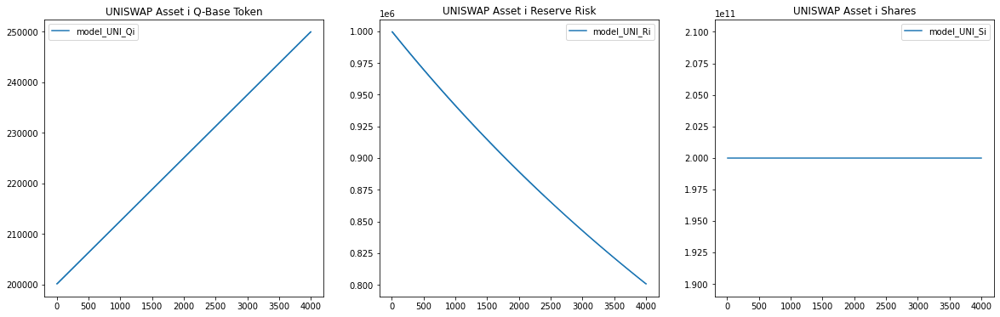

In [9]:
plt.figure(figsize=(20,6))
ax = plt.subplot(131)
model_history.astype(float).plot(ax=ax, y=['model_UNI_Qi'])
plt.title('UNISWAP Asset i Q-Base Token')

ax = plt.subplot(132)
model_history.astype(float).plot(ax=ax, y=['model_UNI_Ri'])
plt.title('UNISWAP Asset i Reserve Risk')

ax = plt.subplot(133)
model_history.astype(float).plot(ax=ax, y=['model_UNI_Si'])
plt.title('UNISWAP Asset i Shares')
plt.show()

The following command line creates a plot of the prices: (for the i-th asset)
- the swap price
- the pool ratio price

the function has the following arguments: 

    def price_plot(experiments,test_title, price_swap, numerator, denominator)

and returns:

    token_ratio = 1/ ( df[numerator] / df[denominator]) 
    
    plt.plot(1/df[price_swap],label='Swap Price', marker='o') 
    
    plt.plot(token_ratio,label='Pool Ratio Price',marker='o') 

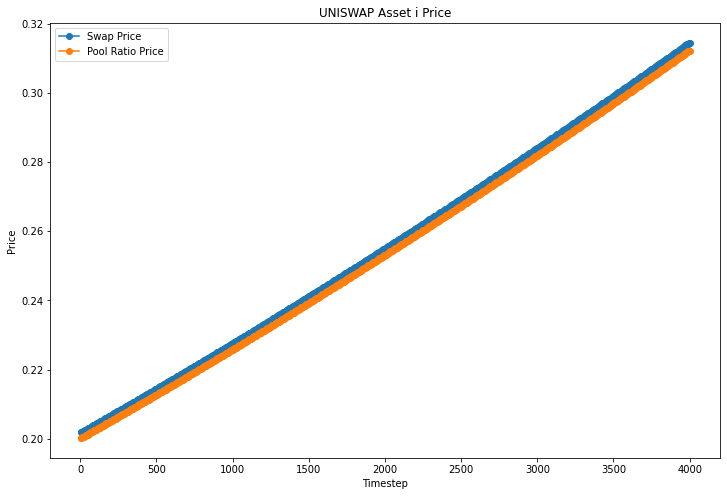

In [10]:
price_plot(rdf,'UNISWAP Asset i Price', 'UNI_P_RQi', 'UNI_Ri', 'UNI_Qi')

The following command lines create three plots that show: (for the j-th asset)
- on the left: the quantity of base asset 'UNI_Qj' 
- center: the quantity of risk asset 'UNI_Rj' 
- on the right: the quantity of shares 'UNI_Sj'
over the simulation steps

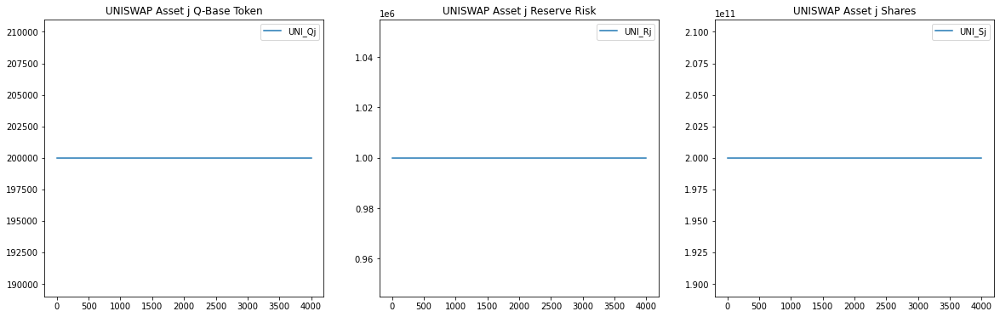

In [11]:
plt.figure(figsize=(20,6))
ax = plt.subplot(131)
uniswap_j.astype(float).plot(ax=ax, y=['UNI_Qj'])
plt.title('UNISWAP Asset j Q-Base Token')

ax = plt.subplot(132)
uniswap_j.astype(float).plot(ax=ax, y=['UNI_Rj'])
plt.title('UNISWAP Asset j Reserve Risk')

ax = plt.subplot(133)
uniswap_j.astype(float).plot(ax=ax, y=['UNI_Sj'])
plt.title('UNISWAP Asset j Shares')
plt.show()

The following command line creates a plot of the prices: (for the j-th asset)
- the swap price
- the pool ratio price

the function has the following arguments: 

    def price_plot(experiments,test_title, price_swap, numerator, denominator)

and returns:

    token_ratio = 1/ ( df[numerator] / df[denominator]) 
    
    plt.plot(1/df[price_swap],label='Swap Price', marker='o') 
    
    plt.plot(token_ratio,label='Pool Ratio Price',marker='o') 

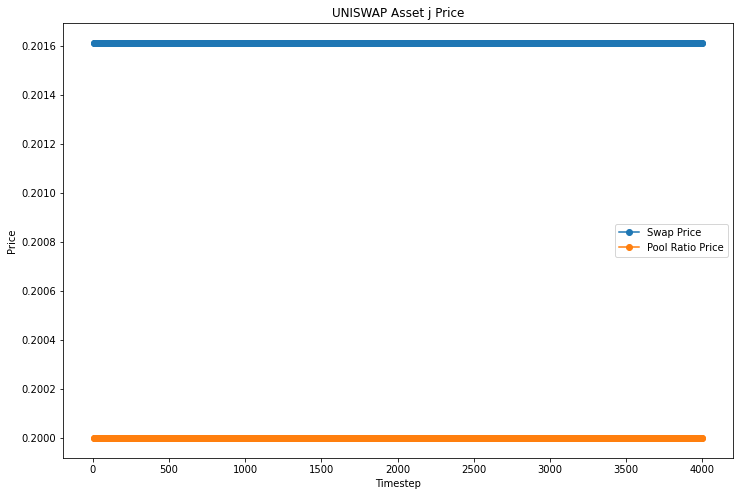

In [12]:
price_plot(rdf,'UNISWAP Asset j Price', 'UNI_P_RQj', 'UNI_Rj', 'UNI_Qj')

The following command lines create three plots that show: (for the base asset)
- on the left: the quantity of base asset in the pool'Hydra_Q' 
- center: the total quantity of base asset in the system 'Hydra_H' 
- on the right: the quantity of base asset shares 'Hydra_Sq'
over the simulation steps

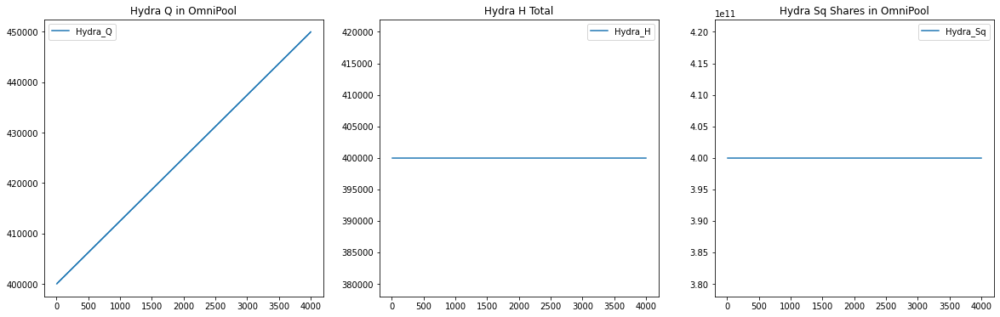

In [13]:
plt.figure(figsize=(20,6))
ax = plt.subplot(131)
hydra.astype(float).plot(ax=ax, y=['Hydra_Q'])
plt.title('Hydra Q in OmniPool')

ax = plt.subplot(132) 
hydra.astype(float).plot(ax=ax, y=['Hydra_H'])
plt.title('Hydra H Total')

ax = plt.subplot(133)
hydra.astype(float).plot(ax=ax, y=['Hydra_Sq'])
plt.title('Hydra Sq Shares in OmniPool')
plt.show()

The following command line creates three plots for the Hydra Omnipool (for the i-th asset)


the function has the following arguments: 

    def hydra_pool_plot(experiments,test_title,T, asset_id):

and for each simulation step appends the following lists:
    
    asset_R = []
    asset_S = []
    asset_P = []

by

    for i in range (df.substep.max(),T,df.substep.max()): 
        asset_R_list = []
        asset_R_list.append(df.pool[i].pool[asset_id]['R'])
        asset_R.append(asset_R_list)
        
        asset_S_list = []
        asset_S_list.append(df.pool[i].pool[asset_id]['S'])
        asset_S.append(asset_S_list)

        asset_P_list = []
        asset_P_list.append(df.pool[i].pool[asset_id]['P'])
        asset_P.append(asset_P_list)

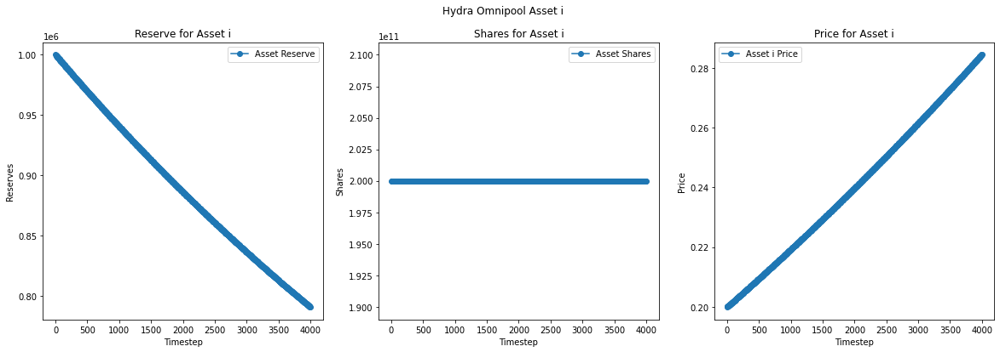

In [14]:
hydra_pool_plot(rdf,'Asset i Reserve and Shares', rdf.last_valid_index(),str('i'))

The following command line creates three plots for the Hydra Omnipool (for the j-th asset)


the function has the following arguments: 

    def hydra_pool_plot(experiments,test_title,T, asset_id):

and for each simulation step appends the following lists:
    
    asset_R = []
    asset_S = []
    asset_P = []

by

    for i in range (df.substep.max(),T,df.substep.max()): 
        asset_R_list = []
        asset_R_list.append(df.pool[i].pool[asset_id]['R'])
        asset_R.append(asset_R_list)
        
        asset_S_list = []
        asset_S_list.append(df.pool[i].pool[asset_id]['S'])
        asset_S.append(asset_S_list)

        asset_P_list = []
        asset_P_list.append(df.pool[i].pool[asset_id]['P'])
        asset_P.append(asset_P_list)

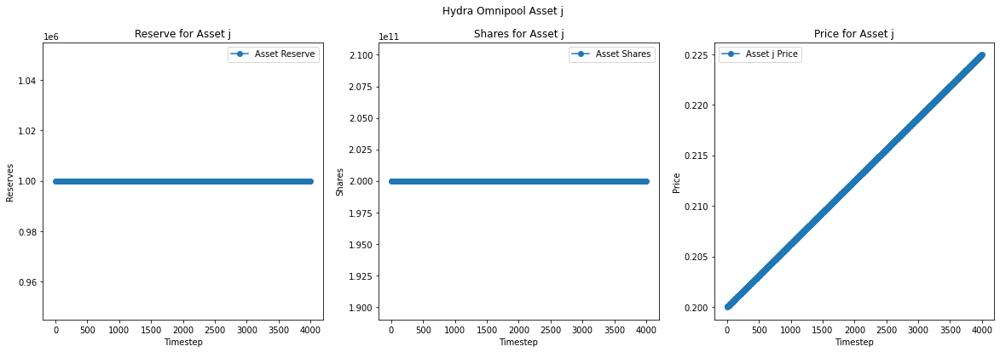

In [15]:
hydra_pool_plot(rdf,'Asset j Reserve and Shares', rdf.last_valid_index(),str('j'))

The following command line creates three plots for the Hydra Omnipool prices (for the i-th and j-th asset)


the function has the following arguments: 

    def hydra_pool_price_plot(experiments,test_title,T, asset_id_list):

and for each simulation step appends the following lists:
    
    asset_P = {k:[] for k in asset_id_list}
    

by

    for asset_id in asset_P:
        asset_P_list = []
    
        for i in range(df.substep.max(),T, df.substep.max()): 
 
            asset_P_list = []
            asset_P_list.append(df.pool[i].pool[asset_id]['P'])
            asset_P[str(asset_id)].append(df.pool[i].pool[asset_id]['P'])

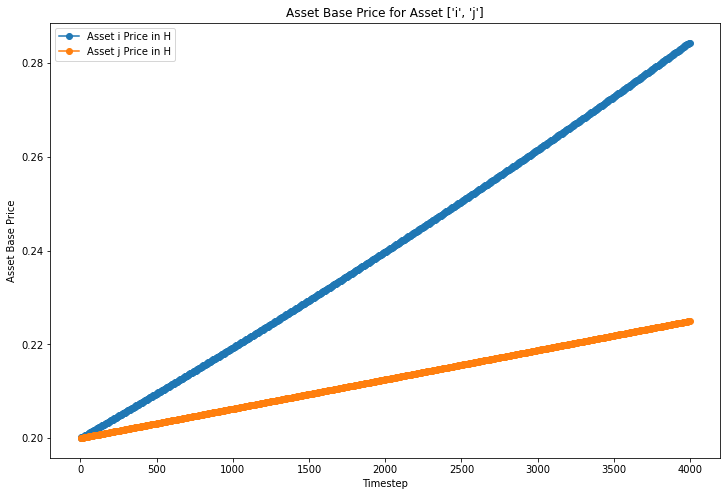

In [16]:
hydra_pool_price_plot(rdf,'Asset Base Price', rdf.last_valid_index(),['i', 'j'])

The following command line creates a table listing all agents in the Hydra system for the first instance of the model and their respective characteristics:
- m: agent number
- r_i_out:
- r_i_in:
- h: 
- q_i:
- s_i:
- s_q:
- r_j_out:
- r_j_in:
- q_j
- s_j:

In [17]:
rdf['hydra_agents'][rdf.first_valid_index()]

,m,r_i_out,r_i_in,h,q_i,s_i,s_q,r_j_out,r_j_in,q_j,s_j
0,0.00,100498.00,0.00,99900.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,1.00,1000000.00,0.00,10000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,2.00,100000.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
3,3.00,100000.00,10000.00,100000.00,10000.00,1000000000.00,0.00,0.00,0.00,0.00,1000000000.00
4,4.00,0.00,0.00,10000.00,0.00,0.00,0.00,1000000.00,0.00,0.00,0.00
5,5.00,0.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
6,6.00,0.00,0.00,1000000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
7,7.00,0.00,0.00,100000.00,0.00,1000000000.00,0.00,100000.00,10000.00,10000.00,1000000000.00


The following command line creates a table listing all agents in the uniswap system for the first instance of the model and their respective characteristics:
- m: agent number
- r_i_out:
- r_i_in:
- h: 
- q_i:
- s_i:
- s_q:
- r_j_out:
- r_j_in:
- q_j
- s_j:

In [18]:
rdf['uni_agents'][rdf.first_valid_index()]

,m,r_i_out,r_i_in,h,q_i,s_i,s_q,r_j_out,r_j_in,q_j,s_j
0,0.00,100498.00,0.00,99900.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,1.00,1000000.00,0.00,10000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,2.00,100000.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
3,3.00,100000.00,10000.00,100000.00,10000.00,1000000000.00,0.00,0.00,0.00,0.00,1000000000.00
4,4.00,0.00,0.00,10000.00,0.00,0.00,0.00,1000000.00,0.00,0.00,0.00
5,5.00,0.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
6,6.00,0.00,0.00,1000000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
7,7.00,0.00,0.00,100000.00,0.00,1000000000.00,0.00,100000.00,10000.00,10000.00,1000000000.00


The following command line creates a table listing all agents in the uniswap system for the tenth instance of the model and their respective characteristics:
- m: agent number
- r_i_out:
- r_i_in:
- h: 
- q_i:
- s_i:
- s_q:
- r_j_out:
- r_j_in:
- q_j
- s_j:

In [19]:
rdf['uni_agents'][rdf.first_valid_index()*10]

,m,r_i_out,r_i_in,h,q_i,s_i,s_q,r_j_out,r_j_in,q_j,s_j
0,0.00,104971.84,0.00,99000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,1.00,1000000.00,0.00,10000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,2.00,100000.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
3,3.00,100000.00,10000.00,100000.00,10000.00,1000000000.00,0.00,0.00,0.00,0.00,1000000000.00
4,4.00,0.00,0.00,10000.00,0.00,0.00,0.00,1000000.00,0.00,0.00,0.00
5,5.00,0.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
6,6.00,0.00,0.00,1000000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
7,7.00,0.00,0.00,100000.00,0.00,1000000000.00,0.00,100000.00,10000.00,10000.00,1000000000.00


The following command line creates a table listing all agents in the Hydra system for the tenth instance of the model and their respective characteristics:
- m: agent number
- r_i_out:
- r_i_in:
- h: 
- q_i:
- s_i:
- s_q:
- r_j_out:
- r_j_in:
- q_j
- s_j:

In [20]:
rdf['hydra_agents'][rdf.first_valid_index()*10]

,m,r_i_out,r_i_in,h,q_i,s_i,s_q,r_j_out,r_j_in,q_j,s_j
0,0.00,104971.84,0.00,99000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,1.00,1000000.00,0.00,10000.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,2.00,100000.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
3,3.00,100000.00,10000.00,100000.00,10000.00,1000000000.00,0.00,0.00,0.00,0.00,1000000000.00
4,4.00,0.00,0.00,10000.00,0.00,0.00,0.00,1000000.00,0.00,0.00,0.00
5,5.00,0.00,0.00,100000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
6,6.00,0.00,0.00,1000000.00,0.00,0.00,0.00,100000.00,0.00,0.00,0.00
7,7.00,0.00,0.00,100000.00,0.00,1000000000.00,0.00,100000.00,10000.00,10000.00,1000000000.00


## Conclusion

The following command line creates eight plots, one for each agents showing his holdings 


the function has the following arguments: 

    def agent_plot(experiments,test_title,T

and for each simulation step appends the following lists:
    
    agent_h = []
    agent_r_i_out = []
    agent_r_i_in = []
    agent_r_j_out = []
    agent_r_j_in = []
    

by

    for i in range (0,T): 
            agent_h_list = []
            agent_h_list.append(df.uni_agents.values[i]['h'][agent_index])
            agent_h.append(np.mean(agent_h_list))
            asset_id = 'i'
            agent_r_i_out_list= []
            agent_r_i_out_list.append(df.uni_agents.values[i]['r_' + asset_id + '_out'][agent_index])
            agent_r_i_out.append(np.mean(agent_r_i_out_list))
    
            agent_r_i_in_list= []
            agent_r_i_in_list.append(df.uni_agents.values[i]['r_' + asset_id + '_in'][agent_index])
            agent_r_i_in.append(np.mean(agent_r_i_in_list))
            
            asset_id = 'j'
            agent_r_j_out_list= []
            agent_r_j_out_list.append(df.uni_agents.values[i]['r_' + asset_id + '_out'][agent_index])
            agent_r_j_out.append(np.mean(agent_r_i_out_list))
    
            agent_r_j_in_list= []
            agent_r_j_in_list.append(df.uni_agents.values[i]['r_' + asset_id + '_in'][agent_index])
            agent_r_j_in.append(np.mean(agent_r_i_in_list))


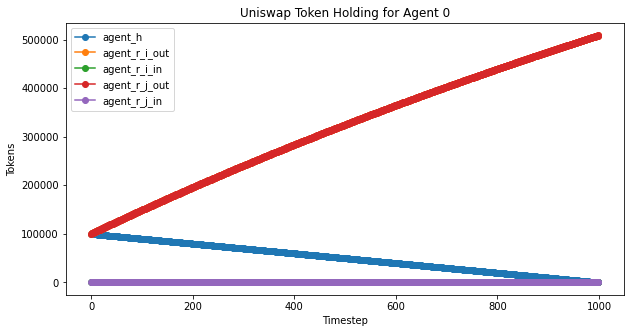

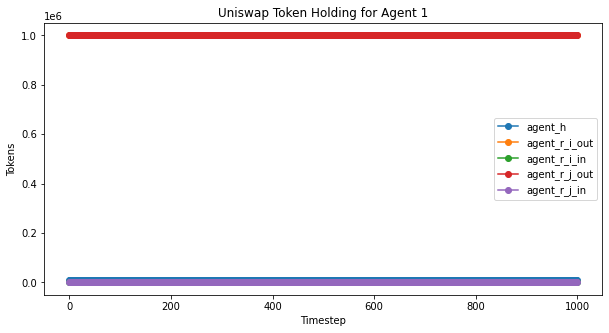

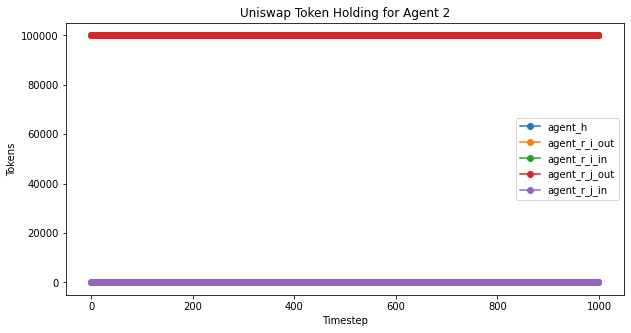

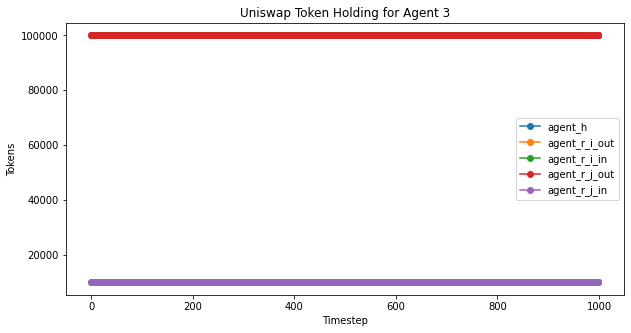

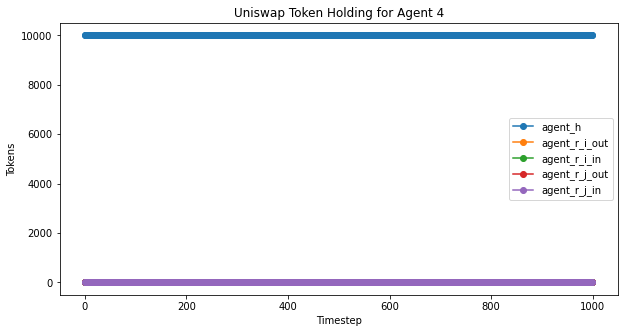

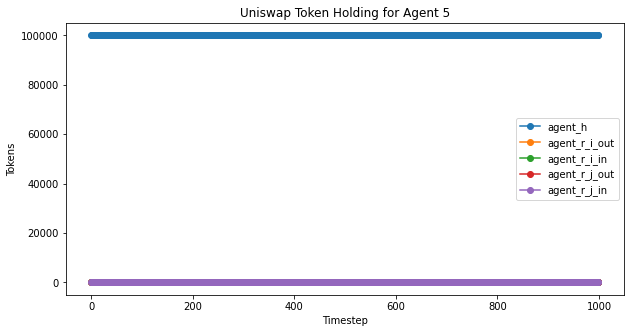

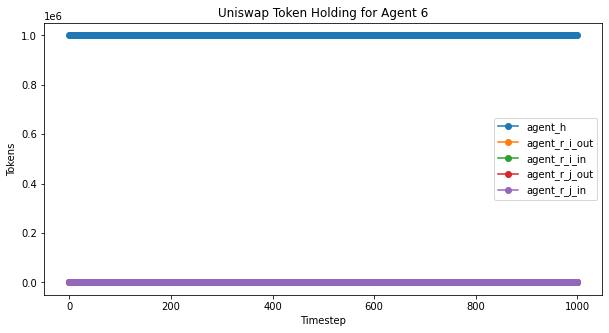

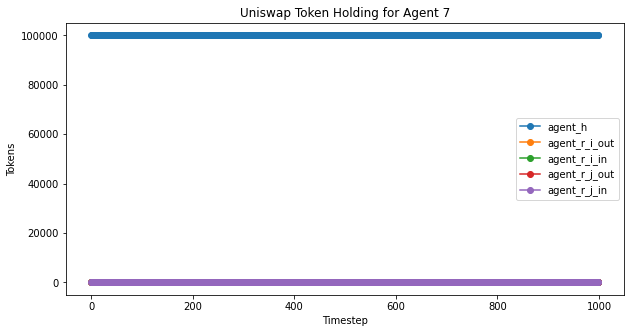

In [21]:
agent_plot(rdf,'Uniswap Token Holding for Agent ', len(rdf['timestep'])) #,4,'j')

The following command line creates eight plots, one for each agents showing his values 


the function has the following arguments: 

    def agent_value_plot(experiments,test_title,T)

and for each simulation step appends the following lists:
    
    agent_h = []
    agent_r_i_out = []
    agent_s_i = []
    agent_r_j_out = []
    agent_s_j = []
    

by

    for i in range (0,T): 
            agent_h_list = []
            agent_h_list.append(df.uni_agents.values[i]['h'][agent_index])
            # agent_h.append(np.mean(agent_h_list))
            agent_h.append(agent_h_list)

            asset_id = 'i'
            agent_r_i_out_list= []
            agent_r_i_out_list.append(df.uni_agents.values[i]['r_' + asset_id + '_out'][agent_index])
            p_rq_list = []
            p_rq_list.append(df['UNI_P_RQ' + asset_id].values[i])
            agent_r_i_out.append(np.divide(agent_r_i_out_list,p_rq_list))
    
            agent_s_i_list= []
            s_i_pool = []
            q_reserve = []
            agent_s_i_list.append(df.uni_agents.values[i]['s_' + asset_id][agent_index])
            s_i_pool.append(df['UNI_S' + asset_id].values[i])
            q_reserve.append(df['UNI_S' + asset_id].values[i])        
            agent_s_i.append(np.multiply(np.divide(agent_s_i_list,s_i_pool),q_reserve))

            asset_id = 'j'
            agent_r_j_out_list= []
            agent_r_j_out_list.append(df.uni_agents.values[i]['r_' + asset_id + '_out'][agent_index])
            p_rq_list = []
            p_rq_list.append(df['UNI_P_RQ' + asset_id].values[i])
            agent_r_j_out.append(np.divide(agent_r_j_out_list,p_rq_list))
    
            agent_s_j_list= []
            s_j_pool = []
            q_reserve = []
            agent_s_j_list.append(df.uni_agents.values[i]['s_' + asset_id][agent_index])
            s_j_pool.append(df['UNI_S' + asset_id].values[i])
            q_reserve.append(df['UNI_S' + asset_id].values[i])        
            agent_s_j.append(np.multiply(np.divide(agent_s_j_list,s_j_pool),q_reserve))

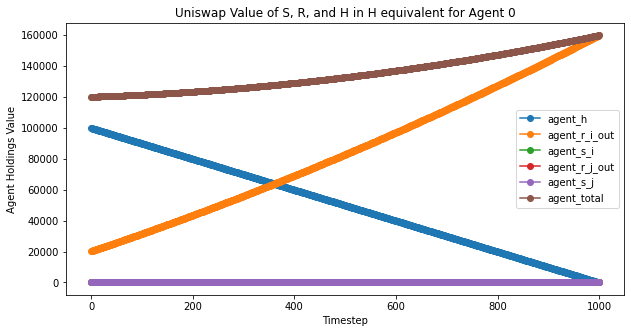

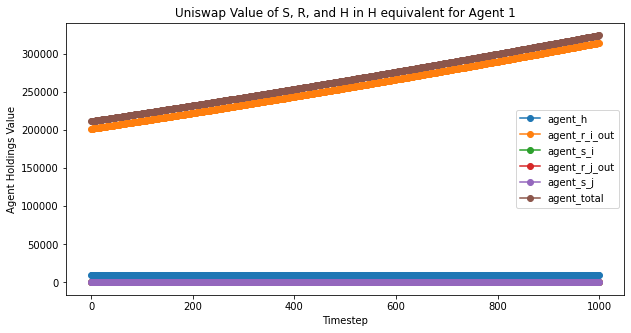

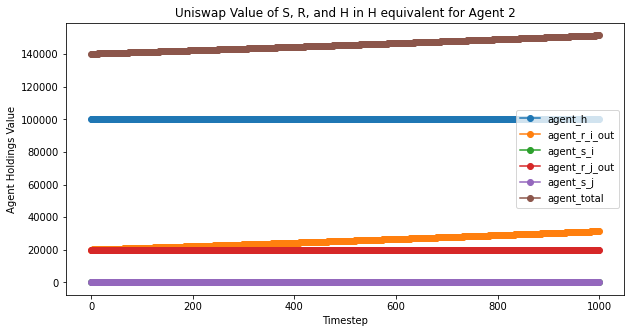

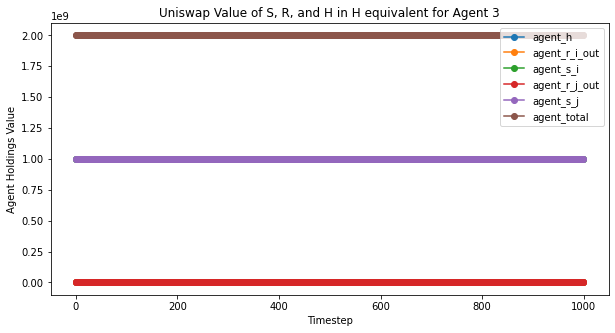

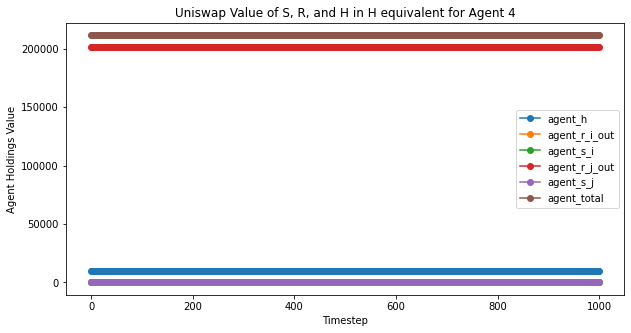

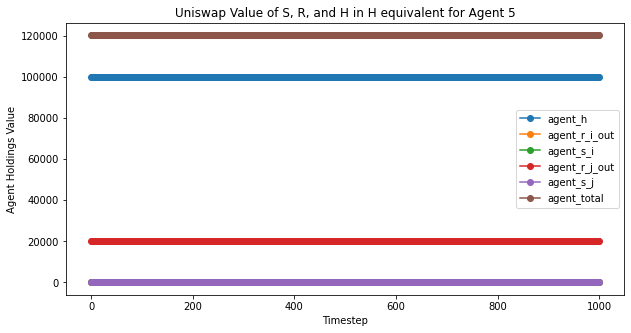

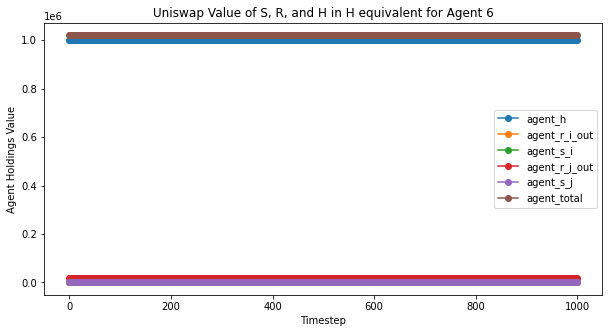

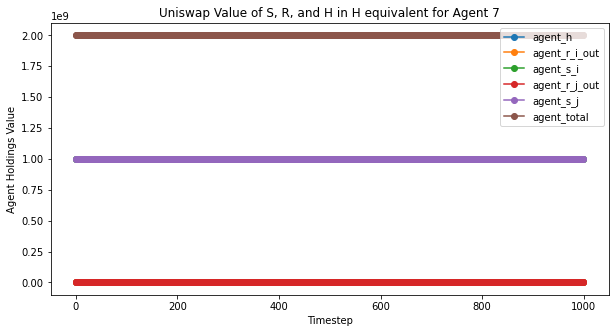

In [22]:
agent_value_plot(rdf,'Uniswap Value of S, R, and H in H equivalent', len(rdf['timestep'])) #,2, 'i')

The following command line creates eight plots, one for each agents showing his holdings (in the Hydra system)


the function has the following arguments: 

    def hydra_agent_plot(experiments,test_title,T):

and for each simulation step appends the following lists:
    
    agent_h = []
    agent_r_i_out = []
    agent_r_i_in = []
    agent_r_j_out = []
    agent_r_j_in = []
    

by

    for i in range (0,T): 
            agent_h_list = []
            agent_h_list.append(df.hydra_agents.values[i]['h'][agent_index])
            agent_h.append(np.mean(agent_h_list))
    
            agent_r_i_out_list= []
            agent_r_i_out_list.append(df.hydra_agents.values[i]['r_i_out'][agent_index])
            agent_r_i_out.append(np.mean(agent_r_i_out_list))
    
            agent_r_i_in_list= []
            agent_r_i_in_list.append(df.hydra_agents.values[i]['r_i_in'][agent_index])
            agent_r_i_in.append(np.mean(agent_r_i_in_list))

            agent_r_j_out_list= []
            agent_r_j_out_list.append(df.hydra_agents.values[i]['r_j_out'][agent_index])
            agent_r_j_out.append(np.mean(agent_r_j_out_list))
    
            agent_r_j_in_list= []
            agent_r_j_in_list.append(df.hydra_agents.values[i]['r_j_in'][agent_index])
            agent_r_j_in.append(np.mean(agent_r_j_in_list))

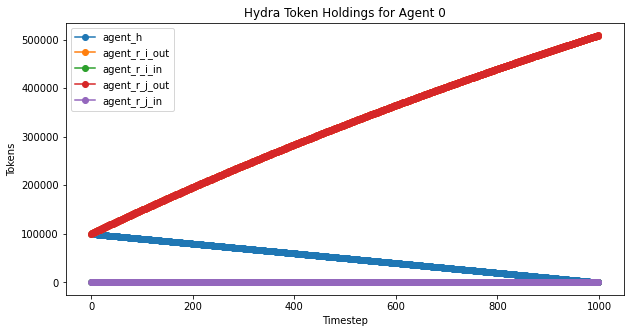

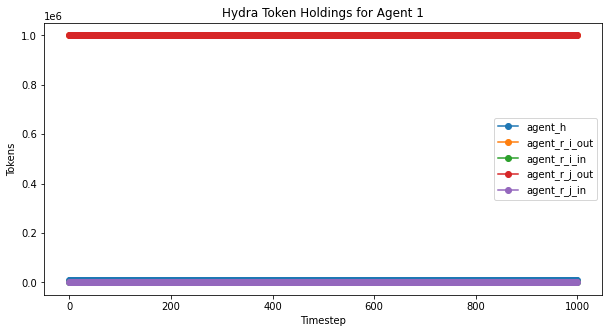

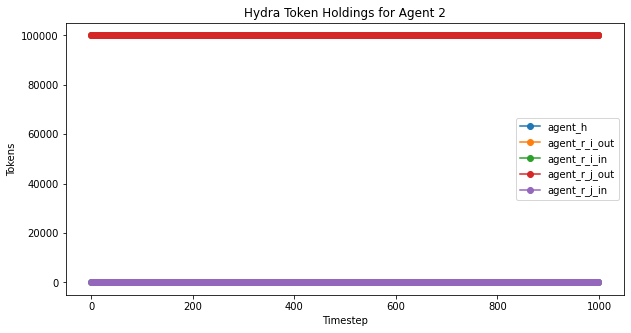

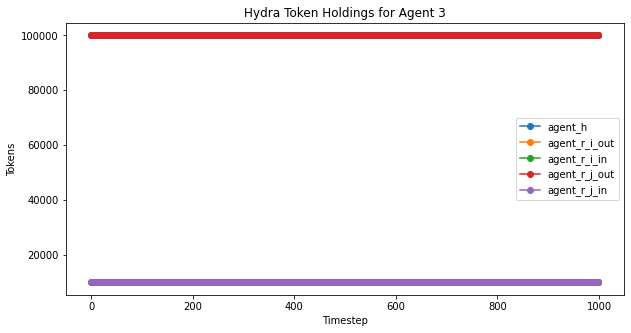

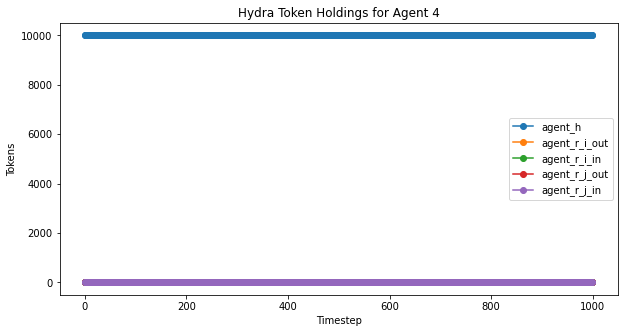

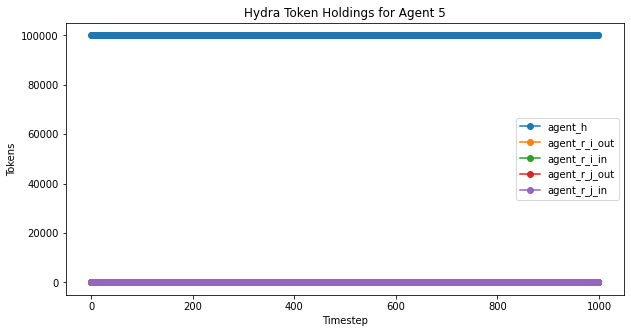

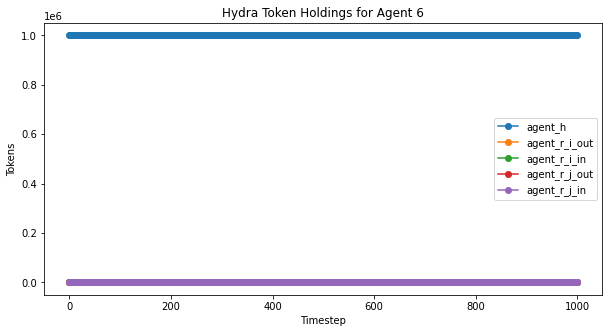

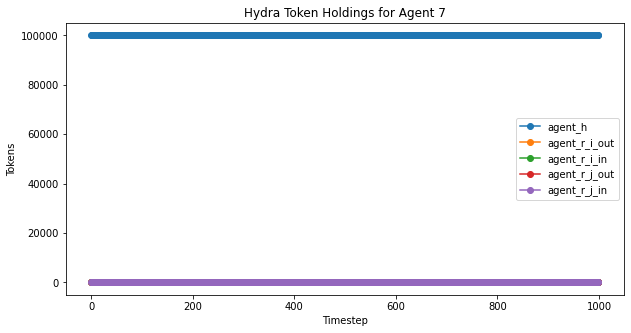

In [23]:
hydra_agent_plot(rdf,'Hydra Token Holdings for Agent ', len(rdf['timestep']))

The following command line creates eight plots, one for each agents showing his values (in the Hydra system)


the function has the following arguments: 

    def hydra_agent_value_plot(experiments,test_title,T)

and for each simulation step appends the following lists:
    
    agent_h = []
    agent_r_i_out = []
    agent_r_i_in = []
    agent_r_j_out = []
    agent_r_j_in = []
    

by

    for i in range(df.substep.max(),T, df.substep.max()): 
            agent_h_list = []
            agent_h_list.append(df.hydra_agents.values[i]['h'][agent_index])
            # agent_h.append(np.mean(agent_h_list))
            agent_h.append(agent_h_list)
    
            asset_id = 'i'
            agent_r_i_out_list= []
            agent_r_i_out_list.append(df.hydra_agents.values[i]['r_' + asset_id + '_out'][agent_index])
            p_rq_list = []
            p_rq_list.append(float(df.pool[i].pool[asset_id]['P']))
            agent_r_i_out.append(np.divide(agent_r_i_out_list,p_rq_list))
    
            agent_s_i_list= []
            s_i_pool = []
            q_reserve = []
            agent_s_i_list.append(int(df.hydra_agents.values[i]['s_' + asset_id][agent_index]))
            s_i_pool.append(int(df.Sq.values[i]))
            q_reserve.append(int(df.Q.values[i]))        
            agent_s_i.append(np.multiply(np.divide(agent_s_i_list,s_i_pool),q_reserve))

            asset_id = 'i'
            agent_r_j_out_list= []
            agent_r_j_out_list.append(df.hydra_agents.values[i]['r_' + asset_id + '_out'][agent_index])
            p_rq_list = []
            p_rq_list.append(float(df.pool[i].pool[asset_id]['P']))
            agent_r_j_out.append(np.divide(agent_r_j_out_list,p_rq_list))
    
            agent_s_j_list= []
            s_j_pool = []
            q_reserve = []
            agent_s_j_list.append(int(df.hydra_agents.values[i]['s_' + asset_id][agent_index]))
            s_j_pool.append(int(df.Sq.values[i]))
            q_reserve.append(int(df.Q.values[i]))        
            agent_s_j.append(np.multiply(np.divide(agent_s_j_list,s_j_pool),q_reserve))

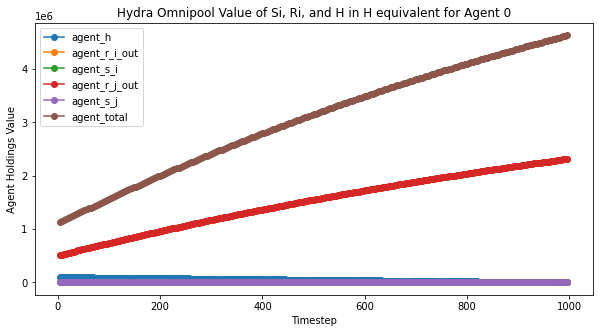

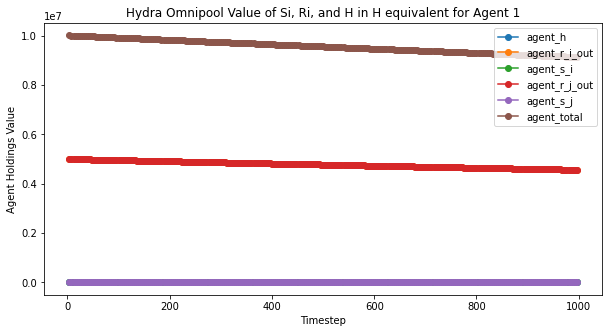

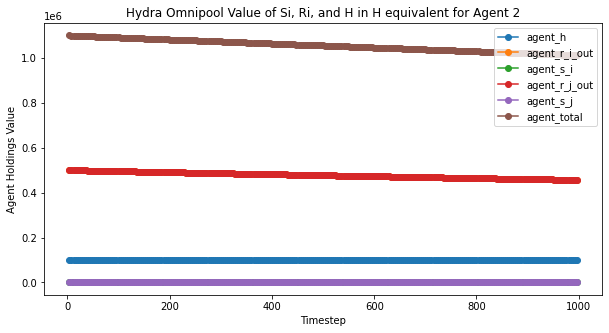

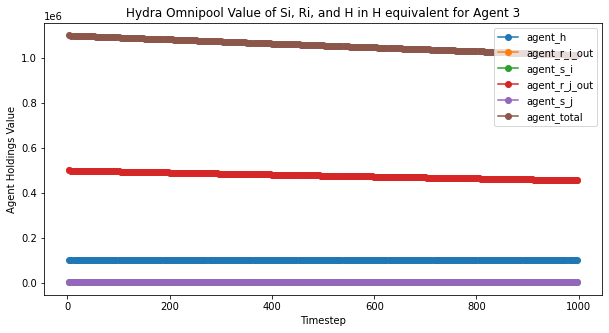

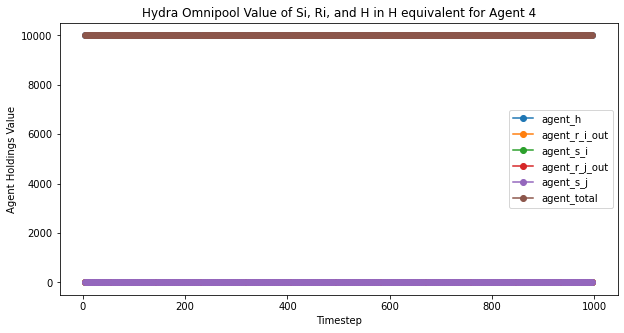

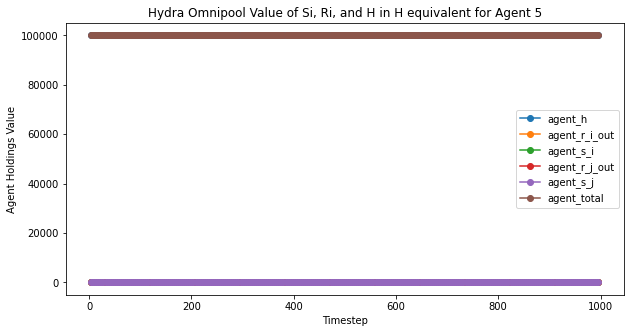

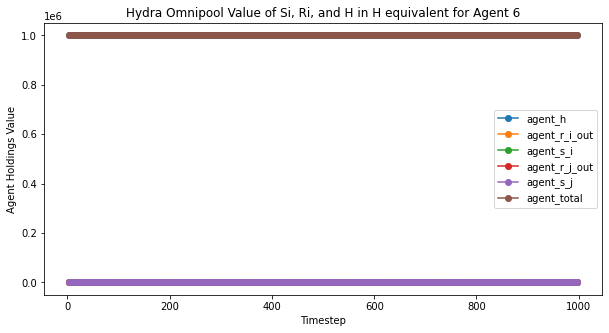

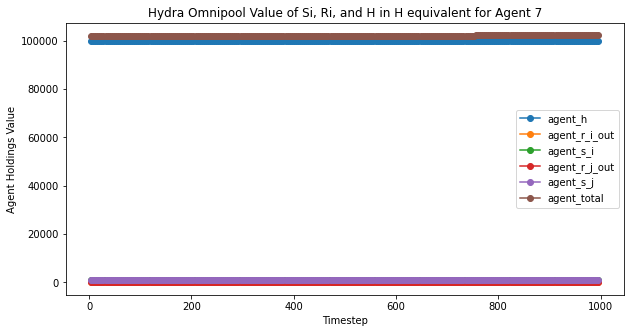

In [24]:
hydra_agent_value_plot(rdf,'Hydra Omnipool Value of Si, Ri, and H in H equivalent', len(rdf['timestep'])) #,2, 'i')

The following command creates a plot of Impermanent Loss which has the following arguments:

    def IL_plot(experiments,test_title, periods)
    
and calculates the IL according to

    
    UNI_IL_i = 2* np.sqrt(df.UNI_P_RQi.pct_change(periods)) / (1 + df.UNI_P_RQi.pct_change(periods)) - 1
    UNI_IL_j = 2* np.sqrt(df.UNI_P_RQj.pct_change(periods)) / (1 + df.UNI_P_RQj.pct_change(periods)) - 1

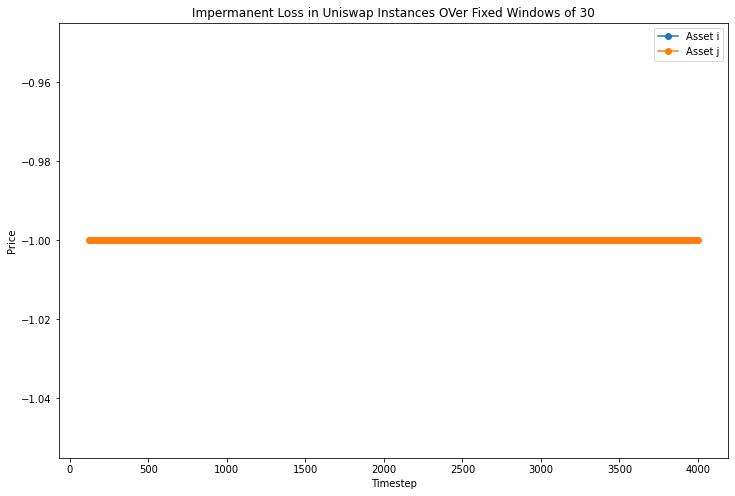

In [25]:
IL_plot(rdf,'Impermanent Loss in Uniswap Instances OVer Fixed Windows of ', 30)